<h2>Kaan Arı<br>
21628042</h2>
<center>
<img align ="center" src="assets/hacettepe.png" alt="Hacettepe University Logo" width="200\">
<h1>Hacettepe University</h1>
<h1>ELE492 : Image Processing - Homework 1</h1>

___

### Q1)
<br>

```
I pledge that I have not received or given any aid in this homework. 
All the work presented below is my own work.
                                                                              - Kaan Arı | 21628042                                                    
```

<img align ="right" src="assets/signature.png" alt="Hacettepe University Logo" width="250">

___

### Q4)

### Preprocessing on Image and Templates

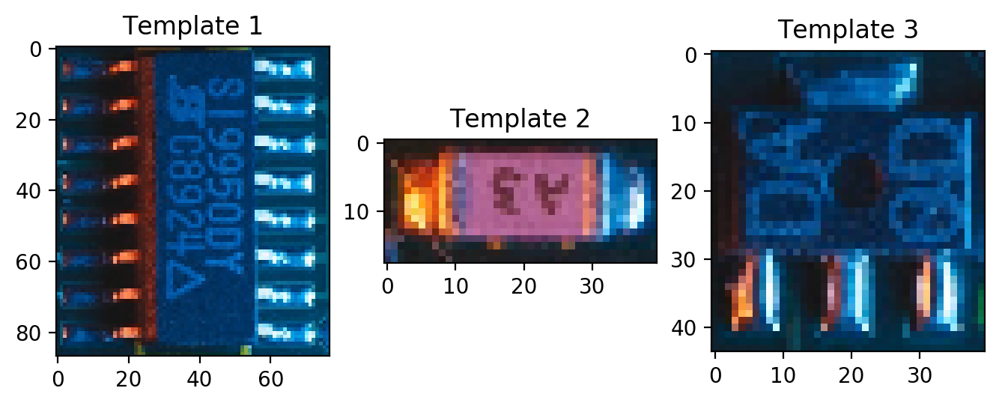

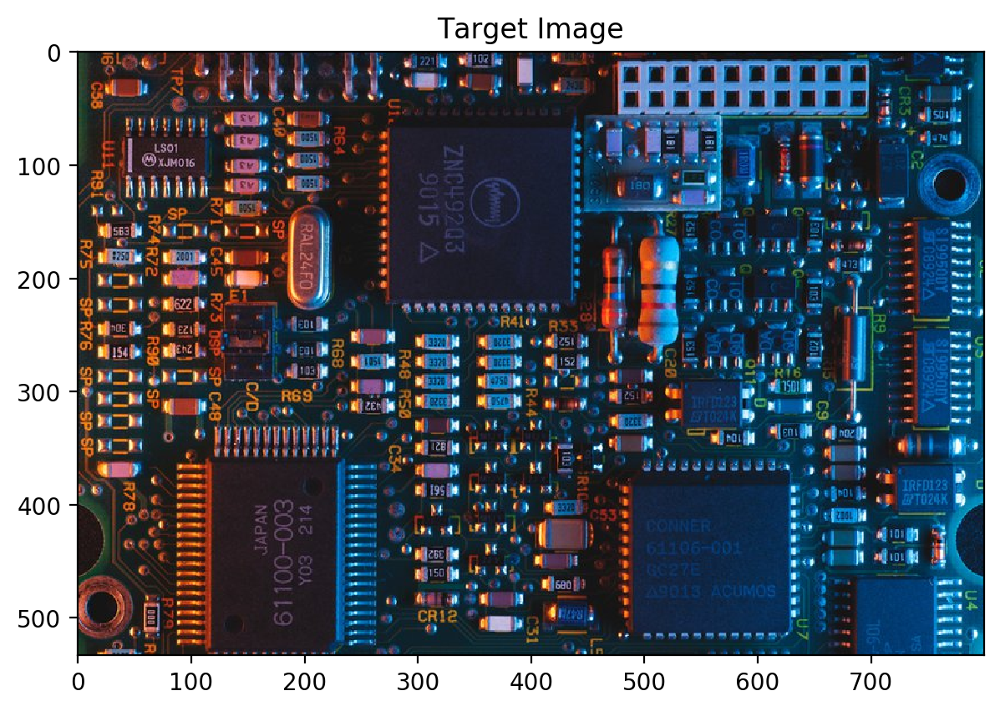

In [7]:
import os
import cv2
from matplotlib import pyplot as plt
import numpy as np

# Create array of templates path and image path
templates_path = ["component"+str(i)+".jpg" for i in range(1,4)] 
image_path     = "fullImage.jpg"

# Read image and templates.
templates = [cv2.cvtColor(cv2.imread("./assets/hw2/"+img), cv2.COLOR_BGR2RGB) for img in templates_path]
image     = cv2.cvtColor(cv2.imread("./assets/hw2/"+image_path), cv2.COLOR_BGR2RGB)

# Template Size (w,h) to resize templates
template_dim = [(77,87), (40,18), (40,44)]

templates_resized = []
for dim,template in zip(template_dim, templates):  
    templates_resized.append(cv2.resize(template, dim))
    
    
f, ax_arr = plt.subplots(1, 3, figsize=(8,7))

for i,subplot in enumerate(ax_arr):
    subplot.set_title("Template {0}".format(i+1))
    subplot.imshow(templates_resized[i])


plt.show()
plt.rcParams['figure.figsize'] = [7, 5]
plt.rcParams['figure.dpi'] = 200 
plt.imshow(image)
plt.title("Target Image")
plt.show()

### Template Matching

##### Method Selecting

I wanted to show all the methods on different components. As you will see in the below, there is not just one best method that works for all component. Therefore, I have to decide which method(s) is suitable for our case. 

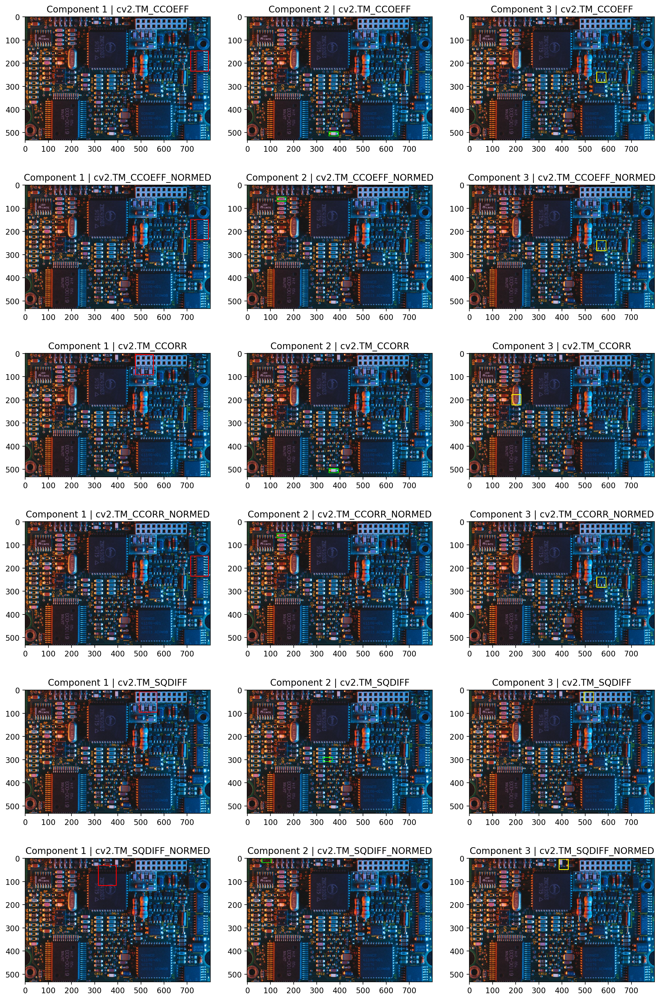

In [8]:
methods = ['cv2.TM_CCOEFF', 'cv2.TM_CCOEFF_NORMED', 'cv2.TM_CCORR',
            'cv2.TM_CCORR_NORMED', 'cv2.TM_SQDIFF', 'cv2.TM_SQDIFF_NORMED']

results = []

# Colors for seperate templates
colors = [(255,0,0), (0,255,0), (255,255,0)]

for template,color,dim in zip(templates_resized,colors,template_dim):
    template_result = []
    
    for method in methods:
        # Apply Template Matching
        res = cv2.matchTemplate(cv2.cvtColor(image,cv2.COLOR_RGB2GRAY), cv2.cvtColor(template,cv2.COLOR_RGB2GRAY), eval(method))
        # Find Maximum and Minumum Matches
        min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)

        # If the method is TM_SQDIFF or TM_SQDIFF_NORMED, take the minimum
        if method in [cv2.TM_SQDIFF, cv2.TM_SQDIFF_NORMED]:
            top_left = min_loc

        else:
            top_left = max_loc

        # Bottom Right coordinate of rectangle
        bottom_right = (top_left[0] + dim[0], top_left[1] + dim[1])
        
        # Drawing rectangle on the original image to mark the result
        img = image.copy()
        cv2.rectangle(img, top_left, bottom_right, color, 2)
        
        # Store the resulting image
        template_result.append(img)

    results.append(template_result)

# Plot results
f, ax_arr = plt.subplots(6, 3, figsize=(15,24))

for j, row in enumerate(ax_arr):
    for i, ax in enumerate(row):
        ax.imshow(results[i][j])
        
        ax.set_title('Component {0} | {1}'.format(i+1,methods[j]))

plt.show()


From the result above, I think I can use **cv2.TM_CCOEFF_NORMED** for all components. It seems like it will work well. Also I selected **normalized** version to use in the future when thresholding.

##### Finding Multiple Instance and Determining Threshold 

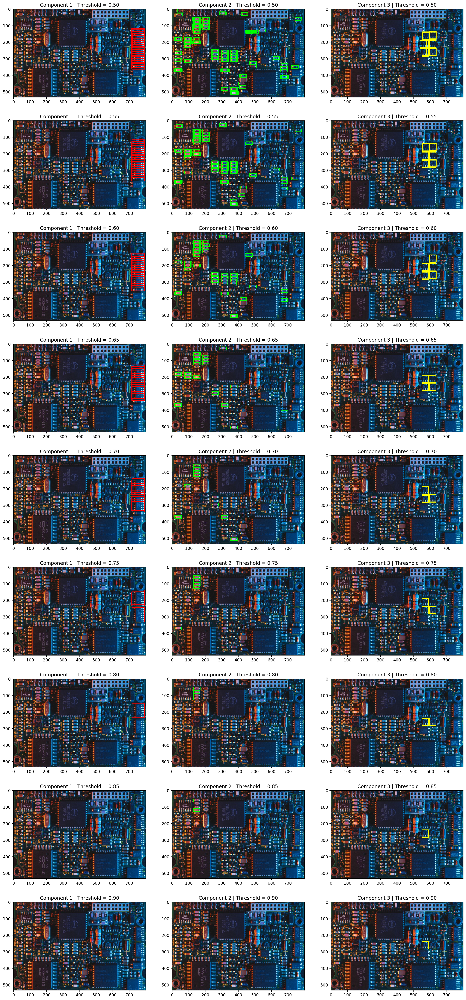

In [9]:
# Selected Method
method = cv2.TM_CCOEFF_NORMED


thresholds = np.arange(0.5,0.95,0.05)
num_threshold = len(thresholds)

results = []

for template,color,dim in zip(templates_resized,colors,template_dim):
    template_result = []
    
    for threshold in thresholds:
        img = image.copy()
        
        # Apply Template Matching
        res = cv2.matchTemplate(cv2.cvtColor(image,cv2.COLOR_RGB2GRAY), cv2.cvtColor(template,cv2.COLOR_RGB2GRAY), method)
        
        # Find all the instance
        instances = np.where(res >= threshold) 
        
        for top_left in zip(instances[1], instances[0]):
            # Bottom Right coordinate of rectangle
            bottom_right = (top_left[0] + dim[0], top_left[1] + dim[1])
            
            # Drawing rectangle on the original image to mark the result
            cv2.rectangle(img, top_left, bottom_right, color, 2)

        
        # Store the resulting image
        template_result.append(img)

    results.append(template_result)
    
# Plot results
f, ax_arr = plt.subplots(9, 3, figsize=(20,45))

for j, row in enumerate(ax_arr):
    for i, ax in enumerate(row):
        ax.imshow(results[i][j])
        
        ax.set_title('Component {0} | Threshold = {1:.2f}'.format(i+1,thresholds[j]))

plt.show()

From the resulting images above, I selected threshold **0.75 for Component 1**, **0.80 for Component 2**, **0.55 for Component 3**. 

Let's see the combination of the results with respect to the selected parameters.

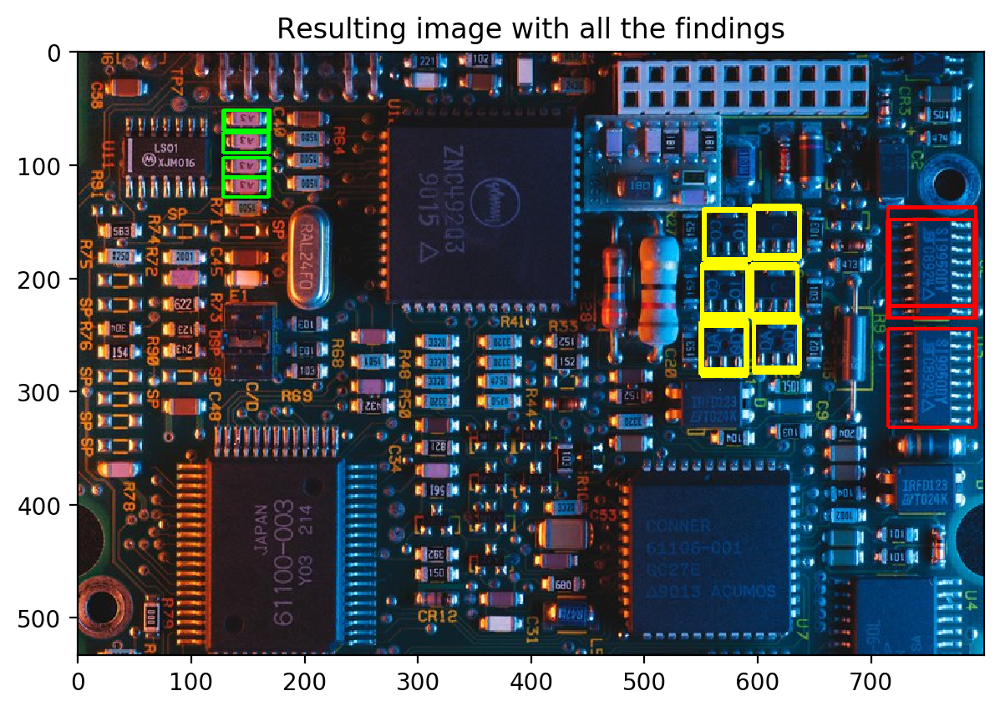

Total Number of Detected Objects = 62


In [10]:

thresholds = [0.75, 0.80, 0.55]

result_image = image.copy()

all_instances = []
all_results   = [] 

for template,color,dim,threshold in zip(templates_resized,colors,template_dim,thresholds):

    # Apply Template Matching
    res = cv2.matchTemplate(cv2.cvtColor(image,cv2.COLOR_RGB2GRAY), cv2.cvtColor(template,cv2.COLOR_RGB2GRAY), method)
    
    # Find instances which passes the threshold
    instances = np.where(res >= threshold)
    # Collect the values of instances
    result    = res[res >= threshold]

    for top_left in zip(instances[1], instances[0]):
        # Bottom Right coordinate of rectangle
        bottom_right = (top_left[0] + dim[0], top_left[1] + dim[1])

        # Drawing rectangle on the original image to mark the result
        cv2.rectangle(result_image, top_left, bottom_right, color, 2)
    
    # Add findings for specific templates to list of all
    all_instances.append(instances)   
    all_results.append(result)
    
# Plot results
plt.imshow(result_image)
plt.title("Resulting image with all the findings")
plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.dpi'] = 200 
plt.show()

total_findings = len(all_instances[0][0]) + len(all_instances[1][0]) + len(all_instances[2][0])

print("Total Number of Detected Objects = {0}".format(total_findings))

So we have a good result over here, except multiple instance which are close to each other. You can not see but there are 62 detected objects in total. 
I printed it by writing `print("Total Number of Detected Objects = {0}".format(total_findings))`.
Normally, we have to find 12 obtects.

To clear multiple detection, we have to use a method called as **non-maximum suppression**. 

In this method, we calculate **IoU (Intersection over Union)** of each findings respect to the each other.
IoU gives us a metric that we can use it for detecting intersection. 

<img align ="center" src="assets/hw2/iou2.png" alt="Intersection over Union" width="350">

After calculation of IoUs for all instance, we can use a threshold value to filter out high intersected instances. As a result, we expect a clear result which we want a one instance for one object.

##### Non-maximum Suppression (Filtering out the unwanted findings)

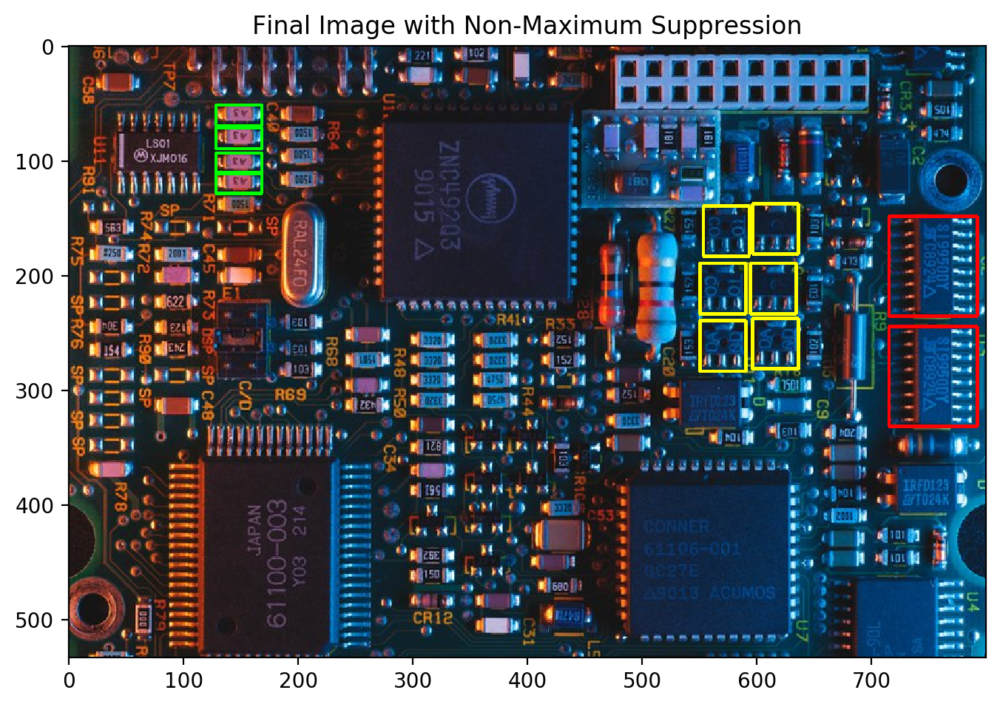

In [5]:
# IoU Threshold
IoU_threshold = 0.5
final_image = image.copy()

for idx_obj,instances in enumerate(all_instances):
    
    # Sort the objects with respect to its matching score to use highest scored first!
    sorted_idx = np.argsort(all_results[idx_obj])[::-1]

    # Creating an Empty List for final result
    individual_instances_idx = []

    for instance_idx in sorted_idx:
        is_intersected = False

        for ind_instance_idx in individual_instances_idx:
            
            # Calculating IoU
            x1 = max(instances[1][ind_instance_idx], instances[1][instance_idx])
            y1 = max(instances[0][ind_instance_idx], instances[0][instance_idx])
            x2 = min(instances[1][ind_instance_idx]+template_dim[idx_obj][0], instances[1][instance_idx]+template_dim[idx_obj][0])
            y2 = min(instances[0][ind_instance_idx]+template_dim[idx_obj][1], instances[0][instance_idx]+template_dim[idx_obj][1])
            
            width  = x2-x1
            height = y2-y1
            
            if not (width <= 0 or height <= 0):
                intersection_area = width * height
                union_area        = 2*template_dim[idx_obj][0]*template_dim[idx_obj][1] - intersection_area
                IoU               = intersection_area/union_area
                
                if IoU >= IoU_threshold:
                    is_intersected = True
                
        
        if not is_intersected:
            individual_instances_idx.append(instance_idx)

            
    # Drawing Boxes on the Image for corresponding template
    for idx in individual_instances_idx:
        # Top Left coordinate of rectangle
        top_left     = (instances[1][idx],instances[0][idx])
        # Bottom Right coordinate of rectangle
        bottom_right = (top_left[0] + template_dim[idx_obj][0], top_left[1] + template_dim[idx_obj][1])

        # Drawing rectangle on the original image to mark the result
        cv2.rectangle(final_image, top_left, bottom_right, colors[idx_obj], 2)

# Show Image
plt.imshow(final_image)
plt.title("Final Image with Non-Maximum Suppression")
plt.show()

___

### Q5)

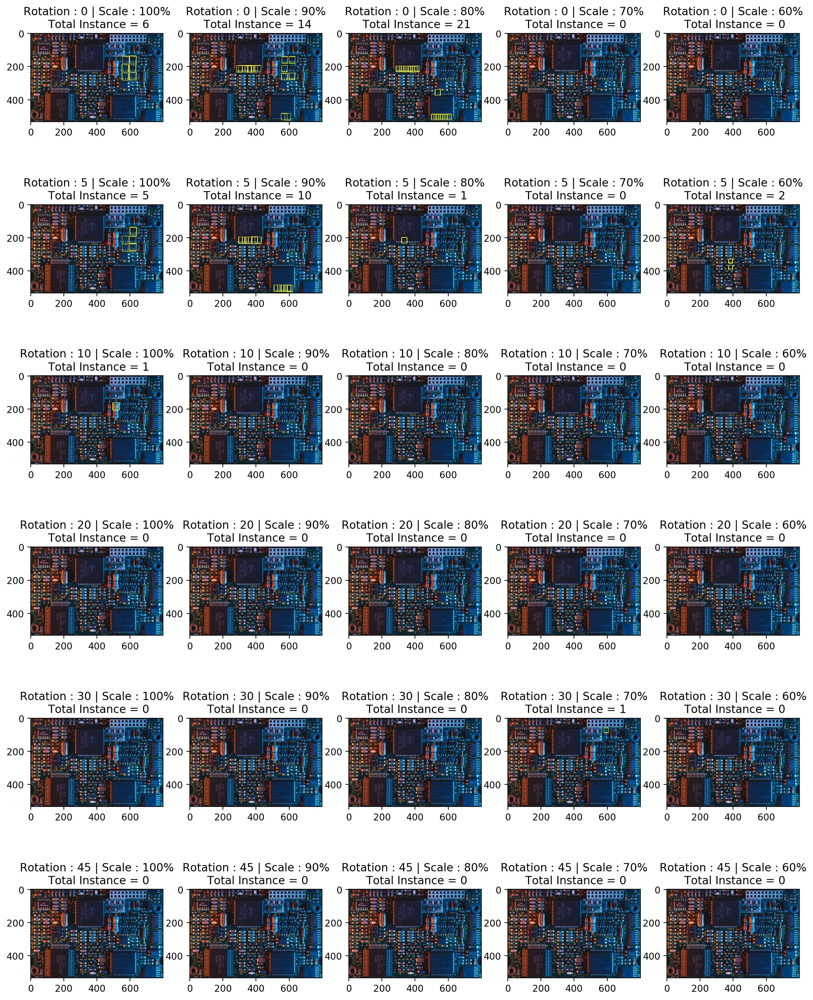

In [11]:
import imutils

# I wrote this class to use previous codes in here as a method
class TransformationPairs:
         
    selected_template = 2
    color             = colors[selected_template]
    template          = templates_resized[selected_template]
    threshold         = thresholds[selected_template]
    
    IoU_threshold = 0.5
    
    def __init__(self, angle, ratio):
        
        self.angle = angle
        self.ratio = ratio
        
        self.width = int(TransformationPairs.template.shape[1]*ratio)
        self.height = int(TransformationPairs.template.shape[0]*ratio)
        self.image = imutils.rotate_bound(TransformationPairs.template, angle)
        self.image = cv2.resize(self.image, (self.width,self.height))
        self.name  = "Rotation : {0:d} | Scale : {1:2d}%".format(int(angle),int(ratio*100))
        self.instance_num = 0
        
    def match_template(self):
        
        # Apply Template Matching
        res = cv2.matchTemplate(cv2.cvtColor(image,cv2.COLOR_RGB2GRAY), cv2.cvtColor(self.image,cv2.COLOR_RGB2GRAY), method)
        
        # Find instances which passes the threshold
        instances = np.where(res >= TransformationPairs.threshold)
        # Collect the values of instances
        result    = res[res >= TransformationPairs.threshold]

        sorted_idx = np.argsort(result)[::-1]
        
        # Creating an Empty List for final result
        individual_instances_idx = []

        for instance_idx in sorted_idx:
            is_intersected = False

            for ind_instance_idx in individual_instances_idx:

                # Calculating IoU
                x1 = max(instances[1][ind_instance_idx], instances[1][instance_idx])
                y1 = max(instances[0][ind_instance_idx], instances[0][instance_idx])
                x2 = min(instances[1][ind_instance_idx]+self.width, instances[1][instance_idx]+self.width)
                y2 = min(instances[0][ind_instance_idx]+self.height, instances[0][instance_idx]+self.height)

                width  = x2-x1
                height = y2-y1

                if not (width <= 0 or height <= 0):
                    intersection_area = width * height
                    union_area        = 2*self.width*self.height - intersection_area
                    IoU               = intersection_area/union_area

                    if IoU >= IoU_threshold:
                        is_intersected = True


            if not is_intersected:
                individual_instances_idx.append(instance_idx)
                
        self.num = len(individual_instances_idx)
        self.name += "\n Total Instance = {}".format(self.num) 
        
        final_image = image.copy()
        # Drawing Boxes on the Image for corresponding template
        for idx in individual_instances_idx:
            # Top Left coordinate of rectangle
            top_left     = (instances[1][idx],instances[0][idx])
            # Bottom Right coordinate of rectangle
            bottom_right = (top_left[0] + self.width, top_left[1] + self.height)

            # Drawing rectangle on the original image to mark the result
            cv2.rectangle(final_image, top_left, bottom_right, TransformationPairs.color, 2)
            
        return final_image


rotation_angles   = [0, 5, 10, 20, 30, 45]
downscale_ratios  = np.arange(1,0.50,-0.10)

combinations = np.array(np.meshgrid(rotation_angles, downscale_ratios)).T.reshape(-1,2)

f, ax_arr = plt.subplots(len(rotation_angles), len(downscale_ratios), figsize=(15,20))

for i, comb in enumerate(combinations):
    transform = TransformationPairs(comb[0], comb[1])
    
    column = i%(len(downscale_ratios))
    row    = int(i/len(downscale_ratios))

    ax_arr[row][column].imshow(transform.match_template())
    ax_arr[row][column].set_title(transform.name)

    
plt.show()

As we can see in the results above, rotation and scaling is crucial for template matching. 
We conclude template matching is very sensitive to slight difference in the rotation or scaling. If they both exist, then the result is even worse.

___